# Unsupervised Learning for stocks clustering (PCA - KMEANS - HCA)

Project combines the following main steps:
* **Wikipedia web-scraping** to collect S&P500 companies' tickers, names and sector information
* **yfinance stock data extraction** to collect daily prices
* **Returns computation** for the desired frequency 
* **Random sampling of stocks** to select the desired subset size
* **Principle Component Analysis (PCA)**
* **K-Means Clustering**
* **Hierarchical Clustering Analysis (HCA)**
* **Correlation Matrices comparison**
* **Clusters composition visualization**
* **Assessment of clustering methods**
* Appendix: **silhouette and elbow** methods to find optimal k

# Imports

In [1]:
import pandas as pd
import numpy as np
import random
import yfinance as yf

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.subplots import make_subplots

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import fcluster,linkage, dendrogram, leaves_list

# Data Preparation

## Loading tickers 

In [2]:
### GET S&P 500 constituents from Wikipedia ###
def get_sp500_cons():
    '''
    Extract S&P 500 companies from wikipedia and store tickers and Sectors / Industries as df
    Returns a df of tickers, name, sectors, and industries
    '''
    URL = 'https://en.wikipedia.org/wiki/List_of_S%26P_500_companies'
    df = pd.read_html(URL)[0]
    df['Symbol'] = df['Symbol'].str.replace('.','-')
    df = df.drop(['Headquarters Location','Date added','CIK','Founded'],axis=1)
    df = df.sort_values(by=['GICS Sector','GICS Sub-Industry'])
    df = df.set_index('Symbol')
    df.dropna(inplace=True)
    return df

In [3]:
# Tickers scrapping
data = get_sp500_cons()
data.head()

/var/folders/sr/2_q1kwss0cg7rt_ny655psg80000gn/T/ipykernel_37662/3925123783.py:9: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df['Symbol'] = df['Symbol'].str.replace('.','-')


,Security,GICS Sector,GICS Sub-Industry
Symbol,,,
IPG,Interpublic Group of Companies (The),Communication Services,Advertising
OMC,Omnicom Group,Communication Services,Advertising
WBD,Warner Bros. Discovery,Communication Services,Broadcasting
CHTR,Charter Communications,Communication Services,Cable & Satellite
CMCSA,Comcast,Communication Services,Cable & Satellite


## Collecting Prices

In [4]:
### GET prices from yfinance ###
def get_prices(tickers,start='1995-12-31'):
    '''
    Dowload prices from yfinance from a list of tickers. 
    Returns a df of daily prices
    '''
    prices  = yf.download(tickers, start=start,interval='1d',)
    prices = prices['Adj Close']
    # fwd fill last prices for missing daily prices
    prices = prices.asfreq('D').ffill()
    return prices

In [5]:
# Collect prices from yfinance into stock_data df
ticker_list = data.index.to_list()
start_date = '2015-01-01'
stock_data = get_prices(tickers=ticker_list,start=start_date)

[*********************100%***********************]  503 of 503 completed


In [6]:
stock_data.head()

,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACGL,ACN,ADBE,...,WYNN,XEL,XOM,XRAY,XYL,YUM,ZBH,ZBRA,ZION,ZTS
Date,,,,,,,,,,,,,,,,,,,,,
2014-12-31,38.084969,50.814610,147.124664,24.767368,45.798306,78.874504,38.343544,19.700001,77.527657,72.699997,...,130.989716,27.941641,62.913494,49.859367,34.242157,44.820736,103.148315,77.410004,23.585791,40.600727
2015-01-01,38.084969,50.814610,147.124664,24.767368,45.798306,78.874504,38.343544,19.700001,77.527657,72.699997,...,130.989716,27.941641,62.913494,49.859367,34.242157,44.820736,103.148315,77.410004,23.585791,40.600727
2015-01-02,37.823860,51.079922,146.459549,24.531769,46.113232,79.136963,38.241341,19.496668,77.119659,72.339996,...,129.343124,28.097219,63.172077,48.605160,34.251156,44.513115,102.393471,77.430000,23.403788,40.864925
2015-01-03,37.823860,51.079922,146.459549,24.531769,46.113232,79.136963,38.241341,19.496668,77.119659,72.339996,...,129.343124,28.097219,63.172077,48.605160,34.251156,44.513115,102.393471,77.430000,23.403788,40.864925
2015-01-04,37.823860,51.079922,146.459549,24.531769,46.113232,79.136963,38.241341,19.496668,77.119659,72.339996,...,129.343124,28.097219,63.172077,48.605160,34.251156,44.513115,102.393471,77.430000,23.403788,40.864925


## Computing Returns

In [7]:
### COMPUTE Returns on specified frequency ###
def get_returns(prices_df,freq='D'):
    '''
    Input daily prices df of prices. Use freq as 'D','B', 'W', or 'M' for daily, business, weekly, or monthly.
    Output returns_df in selected frequency
    '''
    prices_d = prices_df.dropna(axis=0,how='all')
    prices_d = prices_d.dropna(axis=1)
    prices_res = prices_d.resample(freq).last()
    prices_res = prices_res.dropna(axis=1)
    returns = prices_res.pct_change().dropna()
    return returns

In [8]:
# Set Frequency of returns
freq = 'W'
# Compute returns
returns = get_returns(stock_data,freq=freq)
returns.head(3)

,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACGL,ACN,ADBE,...,WYNN,XEL,XOM,XRAY,XYL,YUM,ZBH,ZBRA,ZION,ZTS
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-11,0.00074,-0.035059,0.010974,0.024513,-0.001669,0.028078,0.006681,0.010600,0.010581,-0.006912,...,0.014705,0.001662,-0.007864,0.015983,-0.071166,0.015342,0.049916,0.040165,-0.078826,0.021704
2015-01-18,-0.05765,-0.042484,-0.064255,-0.053745,-0.011485,-0.006236,-0.010498,0.002368,-0.009913,-0.001531,...,-0.013821,0.023217,-0.010641,-0.037907,-0.025446,-0.008422,-0.010236,0.029426,-0.049118,-0.000678
2015-01-25,0.01464,0.118049,0.038533,0.065950,-0.032693,0.024994,-0.014160,0.002700,0.003712,0.032483,...,-0.006667,0.019989,-0.002524,0.002561,0.020308,0.023195,-0.000171,0.015438,0.001211,-0.000385


# Random Sample

In [9]:
### SAMPLE N stocks => returns_df ###
def get_sample(returns,N=returns.shape[1]):
    '''
    Sample N stocks randomly from stocks in returns df columns
    Return a returns_df of random sampled stocks
    '''
    sample = random.sample(returns.columns.to_list(),N)
    return returns[sample]

In [10]:
# Sample N stocks
returns_df = get_sample(returns,N=350)
returns_df.head(3)

,FFIV,RMD,ANET,NUE,C,ROP,GLW,CRM,AVY,ROK,...,UDR,MOS,DE,L,FICO,KIM,PLD,PFE,CMI,KMB
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-11,-0.003376,0.017317,0.059668,-0.025097,-0.064136,-0.031906,0.013038,-0.018231,0.023750,-0.031791,...,0.028734,0.004151,-0.030451,-0.040489,-0.004711,0.042420,0.016578,0.042132,-0.019260,0.003375
2015-01-18,-0.027716,0.044189,-0.028305,-0.070322,-0.062426,-0.037127,-0.006006,-0.026135,-0.005658,-0.026230,...,0.034677,0.000653,0.019265,-0.018477,0.028679,0.044084,0.000000,0.004594,-0.019081,0.014749
2015-01-25,-0.090585,0.074263,-0.017509,-0.013958,0.021214,0.027101,0.029348,0.034958,-0.002655,0.020728,...,0.016304,0.042401,0.012028,0.003307,0.066721,0.009744,0.026274,-0.010671,0.035425,-0.050999


# Principle Component Analysis (PCA)

In [11]:
### RUN PCA ###
def train_PCA(returns, n_comp=20):
    """
    From returns df, compute n_comp PCA and returns W,pca,X_proj,cum_var
    """
    # Set X
    X = returns
    # Standardize returns into X_scal
    scaler = StandardScaler()
    scaler.fit(X)
    X_scal = pd.DataFrame(scaler.transform(X), columns=X.columns, index=X.index) 
    # Run PCA
    pca = PCA(n_comp)
    pca.fit(X_scal)
    # Get PCA loadings
    W = pca.components_
    W = pd.DataFrame(W.T,
                     index=X.columns,
                     columns=pca.get_feature_names_out())
    # Print cum explained variance by n_comp components
    cum_var = np.cumsum(pca.explained_variance_ratio_)
    print(f'Total explained variance:{np.round(cum_var.max(),2)} with {n_comp} PCs')
    
    X_proj = pca.transform(X_scal)
    X_proj = pd.DataFrame(X_proj, columns=pca.get_feature_names_out(),index=X_scal.index)
    
    return W,pca,X_proj,cum_var

Total explained variance:0.67 with 20 PCs


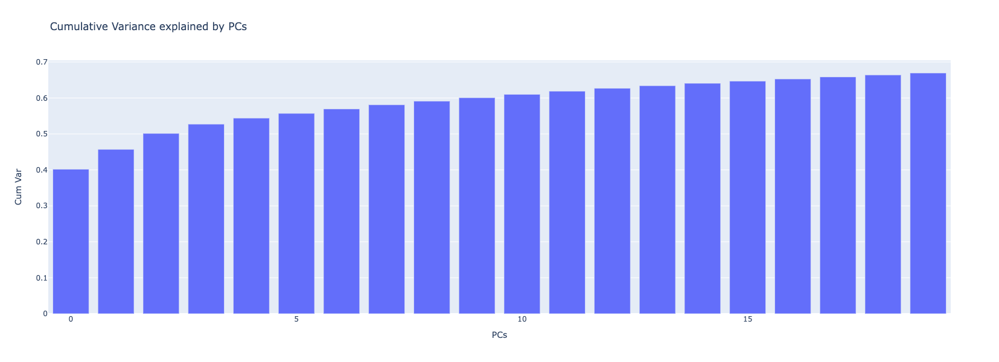

In [12]:
# Run PCA on returns df 
W,pca,X_proj,cum_var = train_PCA(returns_df,n_comp=20)

# Plot total cumulative explained variance using n_comp PCs
fig = px.bar(cum_var,
              width=800,
             height=600,
              title='Cumulative Variance explained by PCs',
            )
fig.update_layout(xaxis_title='PCs', yaxis_title='Cum Var',showlegend=False,)
fig.show()
             

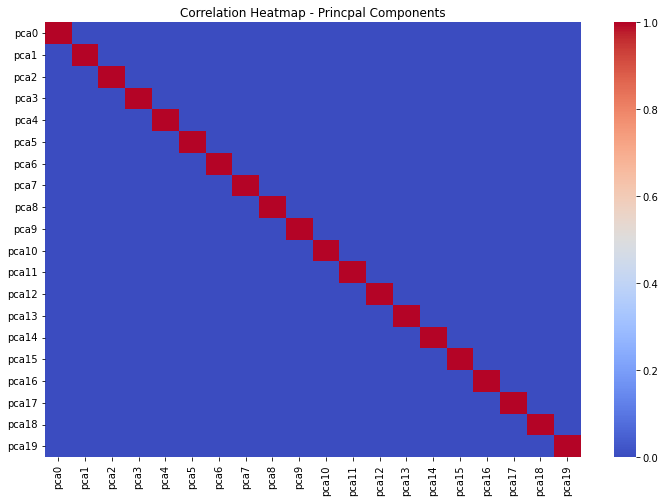

In [13]:
# Quick Viz of PC orthogonality
plt.figure(figsize=(12,8))
sns.heatmap(X_proj.corr(), cmap='coolwarm')
plt.title('Correlation Heatmap - Princpal Components')
plt.show()

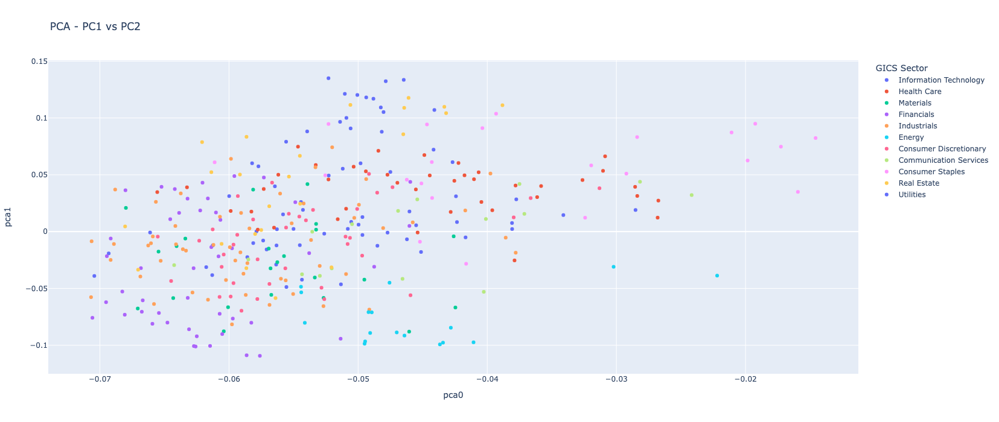

In [14]:
# Plot PC0 vs PC1 - Use Sectors as colors
df = W.join(data[['Security','GICS Sector']])
fig = px.scatter(df, x='pca0', y='pca1',
                    title='PCA - PC1 vs PC2',
                    color='GICS Sector',
                 width=1000,
                 height=700,
                    hover_data=[df.index,df.Security],
               )

fig.show()

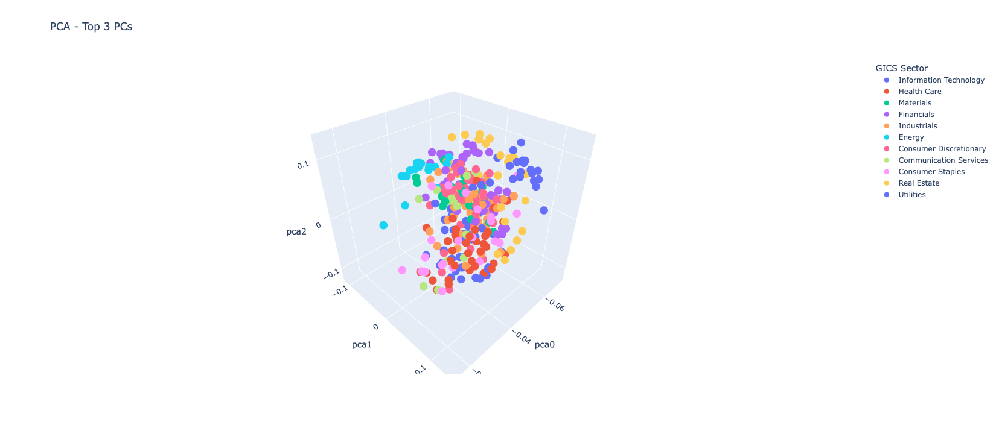

In [15]:
# Plot top 3 PCs
fig = px.scatter_3d(df, x='pca0', y='pca1', z='pca2',
                    title='PCA - Top 3 PCs',
                    width=1000,
                    height=700,
                    color='GICS Sector',
                    hover_data=[df.index,df.Security],
                   )

fig.show()


# K-Mean Clustering

In [16]:
### GET K-Means clusters labels based on PCA ###
def get_pcakmean_clusters(W,k=11):
    """
    From W matrix of PCA loadings for each stock, 
    train K-Means to cluster stocks in k clusters.
    Returns clusters labels assigned to each stock in a df
    """
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(W)
    labels = kmeans.labels_
    # Assign stocks to clusters
    clusters_k = pd.DataFrame(labels,index=W.index,columns=['cluster'])
    clusters_k = clusters_k.sort_values(by='cluster')
    return clusters_k

## Run K-Mean

In [17]:
# Set number of clusters
k = 11 # in-line with GICS Sector classification

# PCA + K-Means cluster labels
clusters_pcak = get_pcakmean_clusters(W,k=k)

# HCA - Hierachical Cluster Analysis

In [18]:
### RUN  HCA ###
def get_hca_clusters(X,k=returns_df.shape[1]/10):
    """
    From X returns_df compute Z linkage matrix on C cov Matrix, 
    use fcluster to split linkage matrix into k clusters
    Returns k clusters labels assigned to each stock in a df
    """
    # Build Covariance Matrix C
    C = X.cov()

    # Compute the linkage matrix using Ward's method
    Z = linkage(C, method='ward', metric='euclidean')

    # Use the fcluster function to split the dendogram into k clusters
    labels = fcluster(Z, k, criterion='maxclust')

    # Assign cluster labels to stocks 
    clusters_h = pd.DataFrame(labels,index=X.columns,columns=['cluster'])
    clusters_h = clusters_h.sort_values(by='cluster')
    return clusters_h, Z

In [20]:
# Set number of clusters
k = 11 # in-line with GICS Sector classification

# Get clusters and linkage matrix Z
clusters_h, Z = get_hca_clusters(returns_df,k=k)

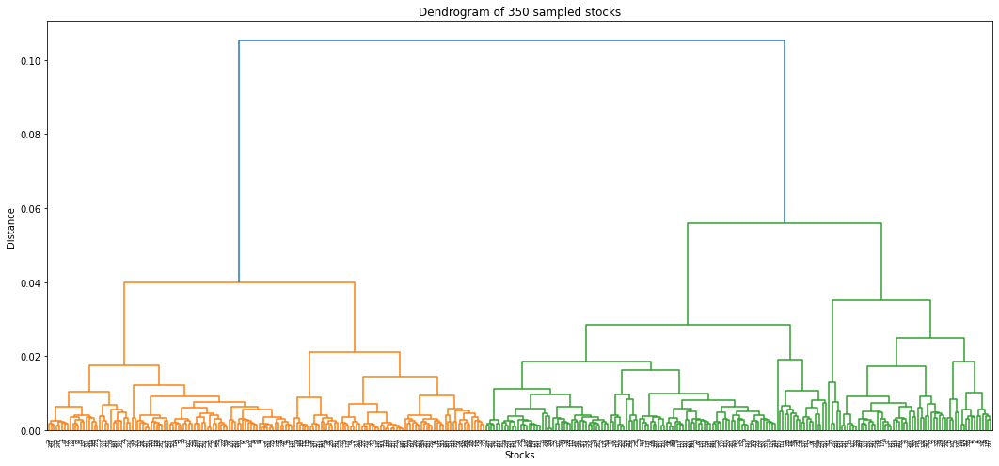

In [21]:
# Plot Dendogram chart
plt.figure(figsize=(18,8))
dendrogram(Z)
plt.title(f'Dendrogram of {returns_df.shape[1]} sampled stocks')
plt.xlabel('Stocks')
plt.ylabel('Distance')
plt.show()


# Correlation Matrices - Clustering methods comparison

In [22]:
# Sort stocks based on HCA leaves (Dendogram level 0)
stocks_names_HCA_sorted = returns_df.T.iloc[leaves_list(Z)].T.columns

# Sort stocks by GICS Sectors
GICS_sorted = returns_df.T.join(data['GICS Sector']).sort_values('GICS Sector')

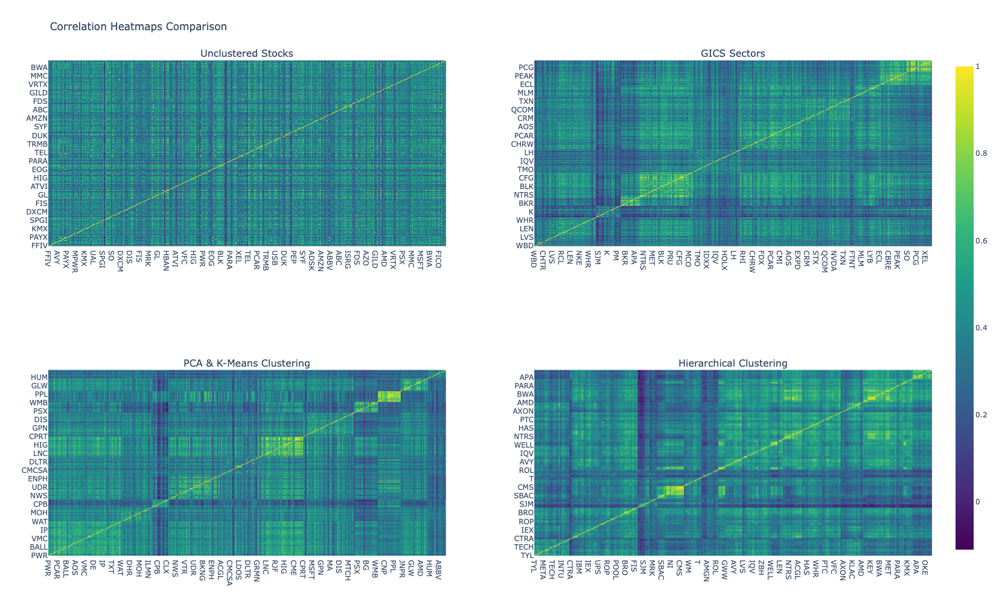

In [23]:
# Plot Correlation Heatmaps
X = returns_df.copy()

fig = make_subplots(rows=2, cols=2, subplot_titles=('Unclustered Stocks', 
                                                    f'GICS Sectors',
                                                    f'PCA & K-Means Clustering',
                                                   'Hierarchical Clustering',
                   ))

heatmap1 = px.imshow(X.corr())
heatmap2 = px.imshow(X[GICS_sorted.index].corr())
heatmap3 = px.imshow(X[clusters_pcak.index].corr())
heatmap4 = px.imshow(X[stocks_names_HCA_sorted].corr())


fig.add_trace(heatmap1.data[0], row=1, col=1)
fig.add_trace(heatmap2.data[0], row=1, col=2)
fig.add_trace(heatmap3.data[0], row=2, col=1)
fig.add_trace(heatmap4.data[0], row=2, col=2)

fig.update_layout(height=1000, 
                  width=900, 
                  showlegend=True,
                  coloraxis={'colorscale': 'viridis'},
                 title='Correlation Heatmaps Comparison')

fig.show()

# Clustering details by stock & sector / within & between correlation assessment

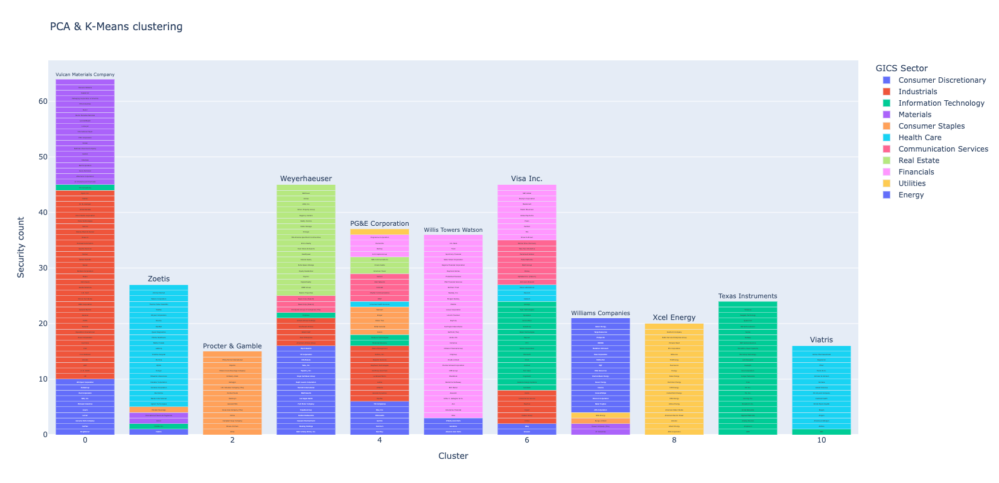

In [25]:
# PCA-K-Means clustering details
clusters = clusters_pcak

df = clusters.join(data)
KMEAN_ret = returns_df.T.join(df).groupby('cluster').mean().T
grouped = df.groupby(['cluster', 'GICS Sector', 'Security']).size().reset_index(name='count')

fig = px.bar(grouped, x='cluster', y='count', color='GICS Sector', title=f'PCA & K-Means clustering',
             barmode='stack',hover_data=['Security'],text='Security',
            height=800,
            width=1400)

fig.update_layout(xaxis_title='Cluster', yaxis_title='Security count', hovermode='closest')
fig.show()


In [26]:
# Within-cluster correlation
df = clusters_pcak.join(data)
within_kmean_corr = []
for c in set(df.cluster.values):
    temp = returns_df.T.join(df)
    temp = temp[temp.cluster == c].T
    temp = temp[:-4]
    temp = temp.astype(float)
    corr_mat = temp.corr()
    upper = np.triu(corr_mat,k=1)
    corr_mean = np.mean(upper[upper!=0])
    if not np.isnan(corr_mean):
        within_kmean_corr.append(corr_mean)
within_corr_mean = np.mean(within_kmean_corr)

# Between-cluster correlation
corr_mat = KMEAN_ret.corr()
upper = np.triu(corr_mat,k=1)
between_corr_mean = np.mean(upper[upper!=0])

corr_comp_df = pd.DataFrame([within_corr_mean,between_corr_mean],index=['Within Corr','Between Corr'],columns=['PCA-KMEAN'])
corr_comp_df

,PCA-KMEAN
Within Corr,0.509558
Between Corr,0.647755


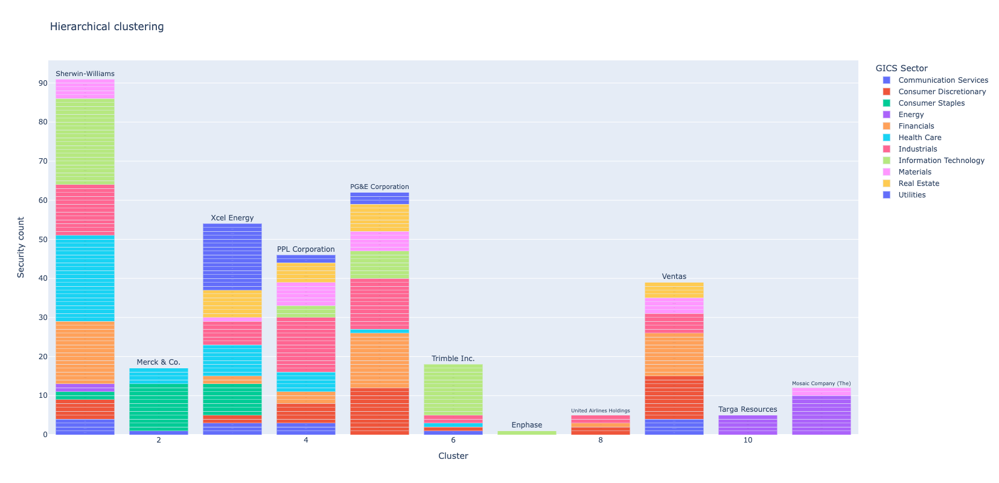

In [27]:
# HCA Clustering details
clusters = clusters_h

df = clusters.join(data)
HCA_ret = returns_df.T.join(df).groupby('cluster').mean().T
grouped = df.groupby(['cluster', 'GICS Sector', 'Security']).size().reset_index(name='count')

fig = px.bar(grouped, x='cluster', y='count', color='GICS Sector', title=f'Hierarchical clustering',
             barmode='stack',hover_data=['Security'],text='Security',
            height=800,
            width=1400)

fig.update_layout(xaxis_title='Cluster', yaxis_title='Security count', hovermode='closest')
fig.show()

In [28]:
# Within-cluster correlation
df = clusters_h.join(data)
within_hca_corr = []
for c in set(df.cluster.values):
    temp = returns_df.T.join(df)
    temp = temp[temp.cluster == c].T
    temp = temp[:-4]
    temp = temp.astype(float)
    corr_mat = temp.corr()
    upper = np.triu(corr_mat,k=1)
    corr_mean = np.nanmean(upper[upper!=0])
    if not np.isnan(corr_mean):
        within_hca_corr.append(corr_mean)
within_corr_mean = np.mean(within_hca_corr)

# Between-cluster correlation
corr_mat = HCA_ret.corr()
upper = np.triu(corr_mat,k=1)
between_corr_mean = np.mean(upper[upper!=0])

corr_comp_df['HCA'] = [within_corr_mean,between_corr_mean]
corr_comp_df

/var/folders/sr/2_q1kwss0cg7rt_ny655psg80000gn/T/ipykernel_37662/1808345271.py:11: RuntimeWarning:

Mean of empty slice



,PCA-KMEAN,HCA
Within Corr,0.509558,0.525430
Between Corr,0.647755,0.584676


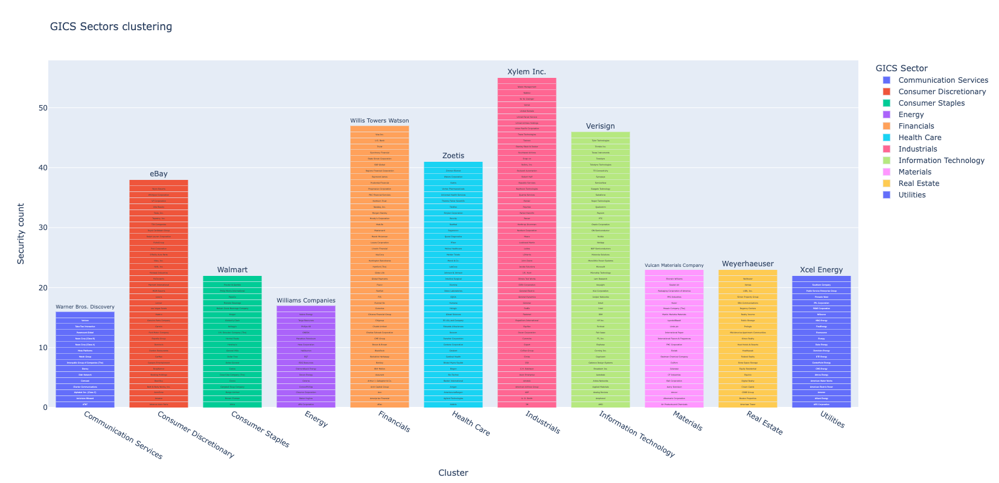

In [29]:
# GICS Clustering details
clusters = returns_df.T

df = clusters.join(data)
GICS_ret = df.groupby('GICS Sector').mean().T
grouped = df.groupby(['GICS Sector', 'Security']).size().reset_index(name='count')

fig = px.bar(grouped, x='GICS Sector', y='count', color='GICS Sector', title=f'GICS Sectors clustering',
             barmode='stack',hover_data=['Security'],text='Security',
            height=800,
            width=1400)

fig.update_layout(xaxis_title='Cluster', yaxis_title='Security count', hovermode='closest')
fig.show()

In [96]:
# Within-cluster correlation
df = returns_df.T.join(data)
within_GICS_corr = []
sector = np.unique(df['GICS Sector'].values)
for c in sector:
    temp = df.copy()
    temp = temp[temp['GICS Sector'] == c].T
    temp = temp[:-4]
    temp = temp.astype(float)
    corr_mat = temp.corr()
    upper = np.triu(corr_mat,k=1)
    corr_mean = np.nanmean(upper[upper!=0])
    if not np.isnan(corr_mean):
        within_GICS_corr.append(corr_mean)
within_corr_mean = np.mean(within_GICS_corr)

# Between-cluster correlation
corr_mat = GICS_ret.corr()
upper = np.triu(corr_mat,k=1)
between_corr_mean = np.mean(upper[upper!=0])

corr_comp_df['GICS'] = [within_corr_mean,between_corr_mean]
corr_comp_df

,PCA-KMEAN,HCA,GICS
Within Corr,0.510,0.525,0.502542
Between Corr,0.648,0.585,0.680897


# APPENDIX: Optimal k number of clusters (silhouette, within cluster distance)

In [31]:
low = 2
high = 50
step = 1

# Calculate silhouette scores for different values of k
from sklearn.metrics import silhouette_score
silhouette_scores = []
sse=[]
W,_,_,_= train_PCA(returns_df,n_comp=20)


for i in range(low,high,step):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(W)
    labels = kmeans.labels_
    # Assign stocks to clusters
    clusters_k = pd.DataFrame(labels,index=W.index,columns=['cluster'])
    clusters_k = clusters_k.sort_values(by='cluster')
    
    silhouette_avg = silhouette_score(returns_df.T,labels)
    silhouette_scores.append(silhouette_avg) # silhouette
    sse.append(kmeans.inertia_) # within-cluster sse

Total explained variance:0.67 with 20 PCs


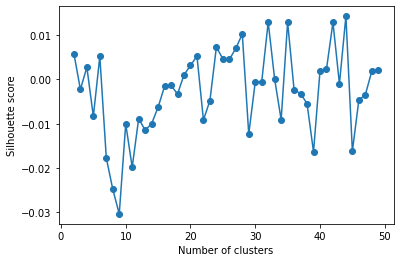

In [32]:
# Plot the silhouette scores
plt.plot(range(low,high,step),silhouette_scores,marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette score')
plt.show()

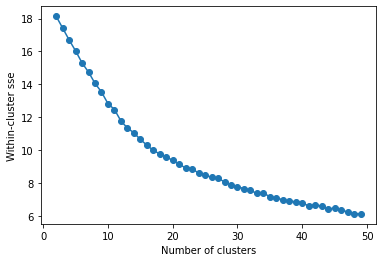

In [33]:
# Plot within cluster sum of squares
plt.plot(range(low,high,step),sse,marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Within-cluster sse')
plt.show()

# Thanks for reading !
**About me** 
* https://www.linkedin.com/in/gribiere/
* https://github.com/GuillaumeRib
* https://troopl.com/gribiere